In [1]:


import pandas as pd 
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import seaborn as sns 
import warnings
import pingouin as pg
warnings.filterwarnings('ignore')
sns.set(font_scale = 1)

In [2]:
new_sample_path = r"C:\Users\amogh\Desktop\Coding\CSR_Research\NEWSAMPLE.csv"
old_sample_path = r"C:\Users\amogh\Desktop\Coding\CSR_Research\data\SAMPLEONE.xlsx"

old_sample = pd.read_excel(old_sample_path,header=0, parse_dates=True)
old_sample.drop(columns=old_sample.columns[0], 
        axis=1, 
        inplace=True)
old_sample.columns = [column.strip(' ') for column in old_sample.columns]
old_sample.Year = pd.to_datetime(old_sample.Year, format = '%Y')
old_sample.set_index('Year',inplace = True)
old_sample.index.rename('Date',inplace = True)
firm_year = old_sample[['Ticker','Firm Age']]
firm_year.index = pd.to_datetime(firm_year.index)
firm_year.index = [ts + pd.tseries.offsets.DateOffset(months = 11, days = 30) for ts in firm_year.index]
firm_year.index.rename('Date',inplace = True)



In [3]:
df= pd.read_csv(new_sample_path,header=0, parse_dates=True)
df.drop(columns=df.columns[0], 
        axis=1, 
        inplace=True)
df.set_index('Date', inplace = True)
df.index = pd.to_datetime(df.index)
df2 = df.reset_index().merge(firm_year.reset_index(), on= ['Date','Ticker'], how = 'outer')
df2.set_index('Date', inplace = True)



In [4]:
df2.columns

Index(['Ticker', 'BOARD_AVERAGE_AGE', 'BOARD_MEETINGS_PER_YR',
       'BOARD_MEETING_ATTENDANCE_PCT', 'BOARD_SIZE', 'CEO_DUALITY',
       'CHIEF_EXECUTIVE_OFFICER_AGE', 'CHIEF_EXECUTIVE_OFFICER_TENURE',
       'CUR_MKT_CAP', 'ENVIRON_DISCLOSURE_SCORE', 'EQY_INST_PCT_SH_OUT',
       'ESG_DISCLOSURE_SCORE', 'FEMALE_CEO_OR_EQUIVALENT',
       'GOVNCE_DISCLOSURE_SCORE', 'INDEPENDENT_DIRECTORS',
       'NUMBER_OF_WOMEN_ON_BOARD', 'PCT_IND_DIRECTORS_ON_COMP_CMTE',
       'PCT_WOMEN_ON_BOARD', 'SOCIAL_DISCLOSURE_SCORE',
       'TOT_COMP_AW_TO_CEO_&_EQUIV', 'BOARD_AVERAGE_TENURE', 'BS_TOT_ASSET',
       'EPS_GROWTH', 'FNCL_LVRG', 'PCT_INSIDER_SHARES_OUT', 'RETURN_COM_EQY',
       'RETURN_ON_ASSET', 'SALES_GROWTH', 'TOBIN_Q_RATIO', 'security_name',
       'gics_sector_name', 'Firm Age'],
      dtype='object')

In [5]:
df2.reset_index()

,Date,Ticker,BOARD_AVERAGE_AGE,BOARD_MEETINGS_PER_YR,BOARD_MEETING_ATTENDANCE_PCT,BOARD_SIZE,CEO_DUALITY,CHIEF_EXECUTIVE_OFFICER_AGE,CHIEF_EXECUTIVE_OFFICER_TENURE,CUR_MKT_CAP,...,EPS_GROWTH,FNCL_LVRG,PCT_INSIDER_SHARES_OUT,RETURN_COM_EQY,RETURN_ON_ASSET,SALES_GROWTH,TOBIN_Q_RATIO,security_name,gics_sector_name,Firm Age
0,2010-12-31,0609237D CT Equity,62.07,17.0,99.00,14.0,0.0,NaN,NaN,2747.5177,...,126.9504,3.5251,1.809,25.8205,7.3248,11.6880,1.5658,TMX Group Inc,NaN,8.0
1,2011-12-31,0609237D CT Equity,61.92,34.0,98.53,12.0,0.0,NaN,NaN,3110.8911,...,-0.6250,2.8056,0.426,20.9519,7.4678,7.6566,1.5642,TMX Group Inc,NaN,9.0
2,2012-12-31,0609237D CT Equity,61.92,34.0,98.53,12.0,0.0,NaN,NaN,3764.8648,...,-0.6250,2.8056,0.663,20.9519,7.4678,7.6566,1.5642,TMX Group Inc,NaN,NaN
3,2013-12-31,0609237D CT Equity,61.92,34.0,98.53,12.0,0.0,NaN,NaN,NaN,...,-0.6250,2.8056,0.663,20.9519,7.4678,7.6566,1.5642,TMX Group Inc,NaN,NaN
4,2014-12-31,0609237D CT Equity,61.92,34.0,98.53,12.0,0.0,NaN,NaN,NaN,...,-0.6250,2.8056,0.663,20.9519,7.4678,7.6566,1.5642,TMX Group Inc,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3932,2012-12-31,TDG CT Equity,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.0
3933,2013-12-31,TDG CT Equity,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.0
3934,2014-12-31,TDG CT Equity,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.0
3935,2015-12-31,TDG CT Equity,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.0


In [6]:
df2 = df2[df2['CUR_MKT_CAP'] > 0]
for i in range(len(df2)):
    if i == 0:
        continue
    elif ((df2.iloc[i]['Firm Age'].is_integer() == False)):
        if (df2.iloc[i]['Ticker'] == df2.iloc[i-1]['Ticker']) and (df2.iloc[i-1]['Firm Age'].is_integer() != False):
            df2['Firm Age'].iat[i] = df2.iloc[i-1]['Firm Age'] + 1
        else:
            df2.iloc[i]['Firm Age'] = 0


In [7]:
df2['LN_BOARD_AVERAGE_AGE'] = np.log(df2['BOARD_AVERAGE_AGE'])
df2['LN_BOARD_MEETINGS_PER_YR'] = np.log(df2['BOARD_MEETINGS_PER_YR'])
df2['LN_TOT_COMP_AW_TO_CEO_&_EQUIV'] = np.log(df2['TOT_COMP_AW_TO_CEO_&_EQUIV'])
df2['LN_CHIEF_EXECUTIVE_OFFICER_TENURE'] = np.log(df2['CHIEF_EXECUTIVE_OFFICER_TENURE'])
df2['Ratio of shares'] = df2['PCT_INSIDER_SHARES_OUT'] / df2['EQY_INST_PCT_SH_OUT']
df2['LN_CHIEF_EXECUTIVE_OFFICER_AGE'] = np.log(df2['CHIEF_EXECUTIVE_OFFICER_AGE'])

In [8]:
df2

,Ticker,BOARD_AVERAGE_AGE,BOARD_MEETINGS_PER_YR,BOARD_MEETING_ATTENDANCE_PCT,BOARD_SIZE,CEO_DUALITY,CHIEF_EXECUTIVE_OFFICER_AGE,CHIEF_EXECUTIVE_OFFICER_TENURE,CUR_MKT_CAP,ENVIRON_DISCLOSURE_SCORE,...,TOBIN_Q_RATIO,security_name,gics_sector_name,Firm Age,LN_BOARD_AVERAGE_AGE,LN_BOARD_MEETINGS_PER_YR,LN_TOT_COMP_AW_TO_CEO_&_EQUIV,LN_CHIEF_EXECUTIVE_OFFICER_TENURE,Ratio of shares,LN_CHIEF_EXECUTIVE_OFFICER_AGE
Date,,,,,,,,,,,,,,,,,,,,,
2010-12-31,0609237D CT Equity,62.070,17.0,99.00,14.0,0.0,NaN,NaN,2747.5177,NaN,...,1.5658,TMX Group Inc,NaN,8.0,4.128263,2.833213,NaN,NaN,0.048029,NaN
2011-12-31,0609237D CT Equity,61.920,34.0,98.53,12.0,0.0,NaN,NaN,3110.8911,NaN,...,1.5642,TMX Group Inc,NaN,9.0,4.125843,3.526361,NaN,NaN,0.015004,NaN
2012-12-31,0609237D CT Equity,61.920,34.0,98.53,12.0,0.0,NaN,NaN,3764.8648,NaN,...,1.5642,TMX Group Inc,NaN,10.0,4.125843,3.526361,NaN,NaN,0.104262,NaN
2010-12-31,0851201D CT Equity,NaN,9.0,96.30,6.0,0.0,NaN,NaN,1019.7246,NaN,...,2.6292,Grande Cache Coal Corp,NaN,10.0,NaN,2.197225,NaN,NaN,0.070751,NaN
2011-12-31,0851201D CT Equity,NaN,7.0,100.00,6.0,0.0,NaN,NaN,974.3007,NaN,...,2.6712,Grande Cache Coal Corp,NaN,11.0,NaN,1.945910,NaN,NaN,0.067960,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,KML CT Equity,57.667,NaN,NaN,6.0,1.0,59.0,3.75,1734.0153,23.2558,...,1.3239,PKM Canada Ltd,Energy,3.0,4.054685,NaN,NaN,1.321756,0.004899,4.077537
2018-12-31,NTR CT Equity,60.733,8.0,98.40,15.0,0.0,48.0,1.58,39283.6150,46.5116,...,1.0926,Nutrien Ltd,Materials,NaN,4.106487,2.079442,16.371951,0.457425,0.001176,3.871201
2019-12-31,NTR CT Equity,59.250,6.0,97.00,12.0,0.0,49.0,2.58,35617.2052,49.6124,...,1.0978,Nutrien Ltd,Materials,2.0,4.081766,1.791759,16.330484,0.947789,0.000610,3.891820


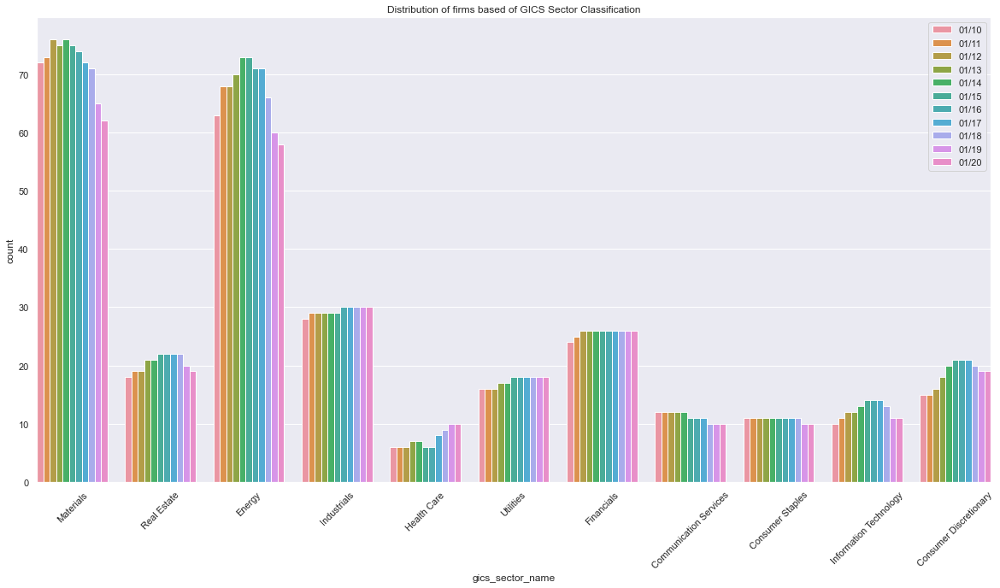

In [9]:
import matplotlib.dates as mdates
import datetime
fig, ax = plt.subplots(figsize = (20,10))
sns.countplot(x = 'gics_sector_name', data = df2.reset_index(), hue = 'Date')
ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
ax.autoscale(enable=True, axis='x', tight=True)
ax.set_title('Distribution of firms based of GICS Sector Classification')
ax.legend(labels = ['01/' + str(10 + date)  for date in range(len(df2.index.unique()))])

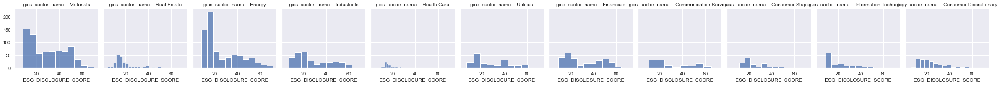

In [10]:
g = sns.FacetGrid(data = df2.reset_index(), col='gics_sector_name',margin_titles=True, despine = True)
g.map(sns.histplot, 'ESG_DISCLOSURE_SCORE')
g.tight_layout()

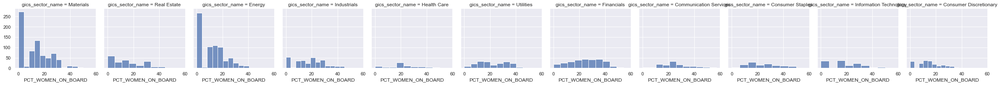

In [11]:
g = sns.FacetGrid(data = df2.reset_index(), col='gics_sector_name',margin_titles=True)
g.map(sns.histplot, 'PCT_WOMEN_ON_BOARD')


In [49]:
# correlations = []
# for year in df2.index.unique(): 
#     correlations.append(df2.loc[year].corr(method = 'spearman'))

# def correlation_plot(correlations):
#     for index,corr in enumerate(correlations):
#         fig, ax = plt.subplots(figsize = (60,30))
#         mask = np.zeros_like(corr)
#         mask[np.triu_indices_from(mask)] = True
#         sns.heatmap(corr, fmt='.2f', 
#                     vmin=corr.values.min(), vmax=1, square=True, cmap=sns.diverging_palette(20, 220, n=200), linewidths=0.1, annot=True, 
#                     annot_kws={"fontsize":14}, cbar=True, mask = mask, ax=ax)
#         ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal",fontdict = {'fontsize': 16})
#         title = str(index + 2010) + ' Correlation Heatmap'
#         ax.set_xticklabels(ax.get_xticklabels(), rotation = 'vertical', fontdict = {'fontsize': 16})
#         ax.set_title(title, fontdict = {'fontsize': 24})
#         cbar = ax.collections[0].colorbar
#         cbar.ax.tick_params(labelsize=20)
#         plt.tight_layout()
#         plt.savefig(f'./{title}.png', bbox_inches='tight', pad_inches=0.0)
# correlation_plot(correlations)


In [38]:
pg.pairwise_corr(method = 'spearman', data = df2.loc['2020'])



,X,Y,method,tail,n,r,CI95%,p-unc,power
0,BOARD_AVERAGE_AGE,BOARD_MEETINGS_PER_YR,spearman,two-sided,247,-0.210764,"[-0.33, -0.09]",8.587556e-04,0.917507
1,BOARD_AVERAGE_AGE,BOARD_MEETING_ATTENDANCE_PCT,spearman,two-sided,246,-0.002638,"[-0.13, 0.12]",9.671629e-01,0.050129
2,BOARD_AVERAGE_AGE,BOARD_SIZE,spearman,two-sided,251,0.195989,"[0.07, 0.31]",1.809382e-03,0.879512
3,BOARD_AVERAGE_AGE,CEO_DUALITY,spearman,two-sided,251,-0.036810,"[-0.16, 0.09]",5.615992e-01,0.089402
4,BOARD_AVERAGE_AGE,CHIEF_EXECUTIVE_OFFICER_AGE,spearman,two-sided,235,0.351902,"[0.23, 0.46]",2.953879e-08,0.999869
...,...,...,...,...,...,...,...,...,...
590,LN_TOT_COMP_AW_TO_CEO_&_EQUIV,Ratio of shares,spearman,two-sided,234,NaN,NaN,NaN,NaN
591,LN_TOT_COMP_AW_TO_CEO_&_EQUIV,LN_CHIEF_EXECUTIVE_OFFICER_AGE,spearman,two-sided,216,-0.053253,"[-0.19, 0.08]",4.361751e-01,0.121900
592,LN_CHIEF_EXECUTIVE_OFFICER_TENURE,Ratio of shares,spearman,two-sided,266,0.238285,"[0.12, 0.35]",8.684202e-05,0.976532
593,LN_CHIEF_EXECUTIVE_OFFICER_TENURE,LN_CHIEF_EXECUTIVE_OFFICER_AGE,spearman,two-sided,248,0.316178,"[0.2, 0.42]",3.675001e-07,0.999248


In [48]:
def render_mpl_table(data, col_width=3.0, row_height=0.625, font_size=22,
                     header_color='#40466e', row_colors=['#f1f1f2', 'w'], edge_color='w',
                     bbox=[0, 0, 1, 1], header_columns=0,
                     ax=None, **kwargs):
    if ax is None:
        size = (np.array(data.shape[::-1]) + np.array([0, 1])) * np.array([col_width, row_height])
        fig, ax = plt.subplots(figsize=size)
        ax.axis('off')
    mpl_table = ax.table(cellText=data.values, bbox=bbox, colLabels=data.columns, **kwargs)
    mpl_table.auto_set_font_size(False)
    mpl_table.set_fontsize(font_size)

    for k, cell in mpl_table._cells.items():
        cell.set_edgecolor(edge_color)
        if k[0] == 0 or k[1] < header_columns:
            cell.set_text_props(weight='bold', color='w')
            cell.set_facecolor(header_color)
        else:
            cell.set_facecolor(row_colors[k[0]%len(row_colors) ])
    return ax.get_figure(), ax
for index,year in enumerate(df2.index.unique()):
    fig,ax = render_mpl_table(pg.pairwise_corr(method = 'spearman', data = df2.loc[year]), header_columns=0, col_width=10, row_height= 1.5, font_size=32)
    title = str(2010 +index) + 'Correlation Table'
    ax.set_title(title)
    fig.savefig(f"{title}.png")

OSError: [Errno 22] Invalid argument: '2010-12-31 00:00:00 Correlation Table.png'